In [9]:
import argparse
import datetime
import json
import numpy as np
import os
import time
from scipy import stats
from pathlib import Path
import torch
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import timm
from torchvision import datasets
import util.misc as misc
import models_mae_shared
from main_test_time_training import load_combined_model
from engine_pretrain import accuracy
from einops import repeat
import tqdm
import os.path

from test_without_adaptation import get_args_parser

In [13]:
DATA_PATH_BASE='/gallery_tate/wonjae.roh/imagenetC'
DATASET='gaussian_noise'
LEVEL='5'
RESUME_MODEL='checkpoints/mae_pretrain_vit_large_full.pth'
RESUME_FINETUNE='checkpoints/prob_lr1e-3_wd.2_blk12_ep20.pth'
OUTPUT_DIR_BASE='outputs'

args_list = ['--data_path' , DATA_PATH_BASE + "/" + DATASET + "/" + LEVEL,
        '--model' , 'mae_vit_large_patch16' ,
        '--input_size' , '224' ,
        '--resume_model'  , 'checkpoints/mae_pretrain_vit_large_full.pth' ,
        '--resume_finetune' , 'checkpoints/prob_lr1e-3_wd.2_blk12_ep20.pth' ,
        '--output_dir' , OUTPUT_DIR_BASE + "/" + DATASET + "/" + "baseline", 
        '--classifier_depth' , '12' , 
        '--head_type' , "vit_head",
        '--device' , 'cpu']

args = get_args_parser()
args = args.parse_args(args_list)
if args.output_dir:
    Path(args.output_dir).mkdir(parents=True, exist_ok=True)

# print args in neat format  
for arg in vars(args):
      print(arg + ": " + str(getattr(args, arg)))



model: mae_vit_large_patch16
input_size: 224
classifier_depth: 12
resume_model: checkpoints/mae_pretrain_vit_large_full.pth
resume_finetune: checkpoints/prob_lr1e-3_wd.2_blk12_ep20.pth
data_path: /gallery_tate/wonjae.roh/imagenetC/gaussian_noise/5
load_optimizer: False
load_loss_scalar: False
predict_rotations: False
norm_pix_loss: False
output_dir: outputs/gaussian_noise/baseline
device: cpu
seed: 0
head_type: vit_head
num_workers: 10


In [14]:
transform_val = transforms.Compose([
        transforms.Resize(256, interpolation=3),
        #transforms.CenterCrop(args.input_size),
        transforms.ToTensor(),
        #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
dataset_val = datasets.ImageFolder(args.data_path, transform=transform_val)
classes = 1000


print(f'Using dataset {args.data_path} with {len(dataset_val)}') 

#model, _, _ = load_combined_model(args, classes)
#_ = model.to(args.device)
all_acc = []
all_losses = []
#model.eval()
data_len = len(dataset_val)

/home2/wonjae.roh/miniconda3/envs/tttmae/lib/python3.8/site-packages/torchvision/transforms/transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


Using dataset /gallery_tate/wonjae.roh/imagenetC/gaussian_noise/5 with 50000


In [10]:
import matplotlib.pyplot as plt

# visualize tensor in (batch_size, 3, 224, 224) format

def visualize_tensor(tensor):
    tensor = tensor.permute(0, 2, 3, 1)
    tensor = tensor.detach().cpu().numpy()

    # show 50 images in subplots
    fig, axes = plt.subplots(5, 10, figsize=(20, 10))
    axes = axes.flatten()
    for img, ax in zip(tensor, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()
    

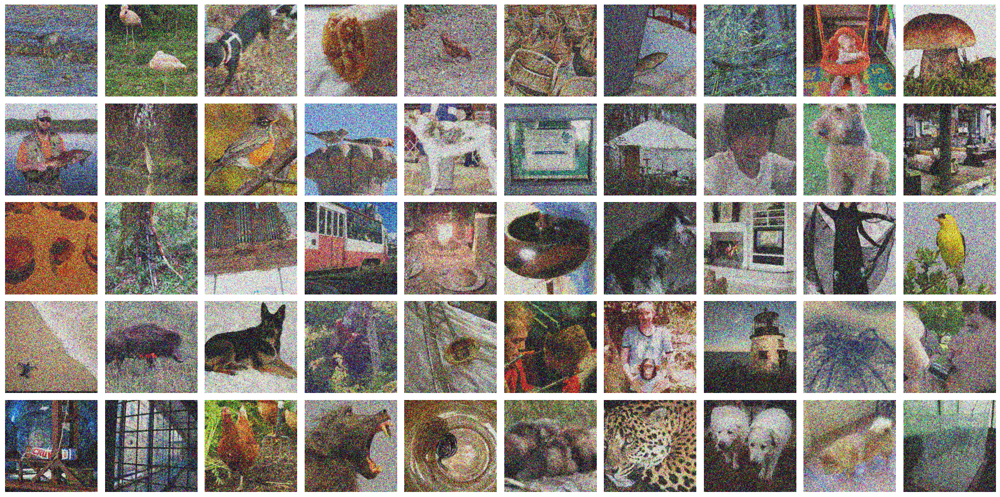

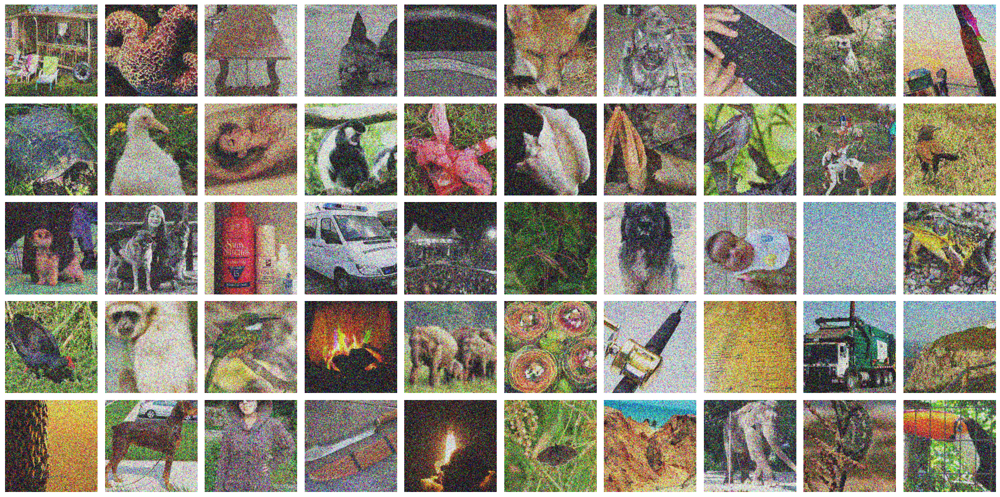

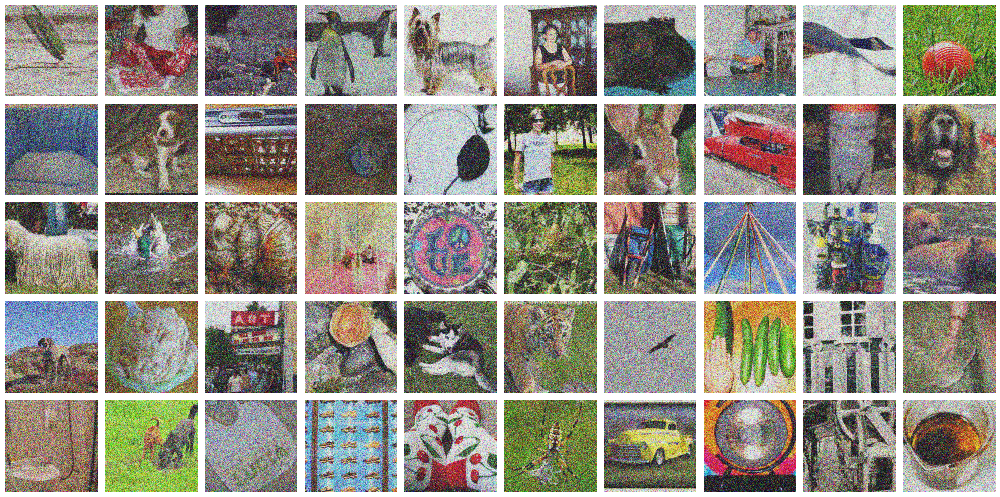

In [15]:
data_loader = DataLoader(dataset_val, batch_size=50, shuffle=True)

for index, (samples, labels) in enumerate(data_loader):

    visualize_tensor(samples)

    user_input = input("paused")
    if user_input:
        break
    else:
        continue
